In [1]:
import numpy as np
%matplotlib notebook
import matplotlib.pyplot as plt

import pickle

import librosa
from pathlib import Path

from IPython.display import Audio
from microphone import record_audio

import matplotlib.mlab as mlab

from os import listdir
from os.path import isfile, join

In [2]:
def load_song_from_path(path: str):
    """
    Loads a song from a path.
    
    Returns the samples, sampling rate, and duration.
    
    Parameters
    ------------
    path: str
          The path for the specified audio file
          
    Returns
    -------
    Tuple[np.narray, int, float]
        The list of samples, the sampling rate and the duration of the song
    """
    song_path = Path(path)
    samples, sampling_rate = librosa.load(song_path, sr=None)
    duration = librosa.get_duration(y = samples, sr = sampling_rate)
    
    return samples, sampling_rate, duration

In [3]:
def load_music_files(directory: str):
    """
    Loads the files in a folder.
    
    Returns the samples from each file.
    
    Parameters
    ------------
    directory: str
          The path for the specified folder
          
    Returns
    -------
    List
        Names of all of the songs
    np.ndarray size: (M,N)
        The array of samples for each song
    """
    files = [f for f in listdir(directory) if isfile(join(directory, f))]
    music_list = np.array([load_song_from_path(directory + paths)[0] for paths in files])
    return files, music_list


In [4]:
sampling_rate=44100
names, music_list = load_music_files("Music/")
print(music_list)
print(names)
Audio(music_list[3], rate=sampling_rate)

[array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
       6.1035156e-05, 3.0517578e-05], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)
 array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)]
['Clair de lune - Debussy (guitare).mp3', 'Crazy Town - Megatron (Official Audio).mp3', 'Creedence Clearwater Revival - I Put A Spell On You.mp3', 'Fuel - Metallica [HQ Audio].mp3', 'Grace - Lamb of God.mp3', 'Jerry Was A Race Car Driver.mp3', 'Liszt - Un Sospiro.mp3', 'Living Colour - Cult Of Personality (Official Video).mp3', 'Roll Over Beethoven.mp3', 'Yesterday - Atmosphere.mp3']


<IPython.core.display.Javascript object>


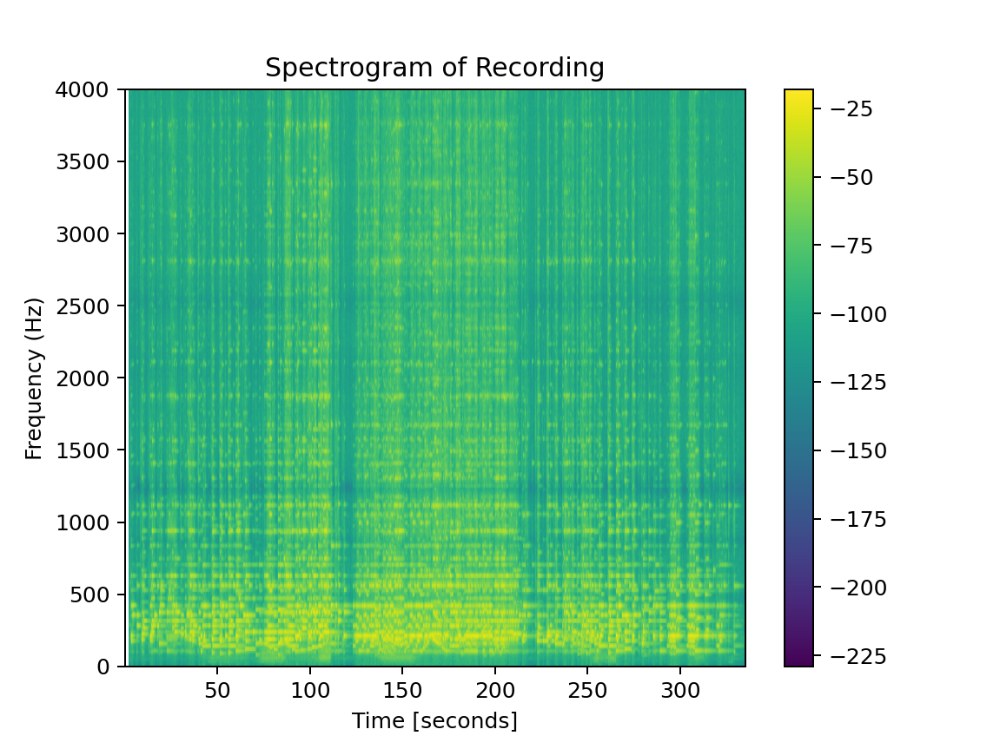

C:\Users\andre\Anaconda3\envs\week1\lib\site-packages\matplotlib\axes\_axes.py:7594: RuntimeWarning: divide by zero encountered in log10
  Z = 20. * np.log10(spec)


In [5]:
fig, ax = plt.subplots()

S, freqs, times, im = ax.specgram(
    music_list[0],
    NFFT=4096,
    Fs=sampling_rate,
    window=mlab.window_hanning,
    noverlap=4096 // 2,
    mode='magnitude',
    scale="dB"
)
fig.colorbar(im)

ax.set_xlabel("Time [seconds]")
ax.set_ylabel("Frequency (Hz)")
ax.set_title("Spectrogram of Recording")
ax.set_ylim(0, 4000);

In [6]:
def return_specgram(samples: np.ndarray, sampling_rate: int):
    """
    Creates the spectrogram for a specific set of samples
    
    Returns the spectrogram, the frequencies, and the times
    
    Parameters
    ------------
    samples: np.ndarray
          The array of samples
    sampling_rate: int
          The sampling rate
    Returns
    -------
    Tuple[np.narray, np.narray, np.narray]
        The spectrogram 2d array, the frequencies and the timestamps
    """
    S, freqs, times = mlab.specgram(
        samples,
        NFFT=4096,
        Fs=sampling_rate,
        window=mlab.window_hanning,
        noverlap=int(4096 / 2),
        mode='magnitude'
    )
    return S, freqs, times

In [7]:
S = {}
freqs = {}
times = {}
for i in range(len(music_list)):    
    spectrograms = return_specgram(music_list[i], 44100)
    S[names[i]] = spectrograms[0]
    freqs[names[i]] = spectrograms[1]
    times[names[i]] = spectrograms[2]
print(S)
print(freqs)
print(times)

with open('spectrograms.pickle', 'wb') as handle:
    pickle.dump(S, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('frequencies.pickle', 'wb') as handle:
    pickle.dump(freqs, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('times.pickle', 'wb') as handle:
    pickle.dump(times, handle, protocol=pickle.HIGHEST_PROTOCOL)


{'Clair de lune - Debussy (guitare).mp3': array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.34463646e-07, 2.24385436e-07, 1.96351900e-07],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.61646004e-07, 1.44453294e-07, 1.16187607e-07],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.67369032e-07, 2.61563201e-07, 1.22281290e-07],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.42151615e-08, 4.32273404e-08, 4.56902612e-08],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.28299788e-08, 2.32861373e-08, 4.09787933e-08],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        8.81781238e-09, 7.12895656e-09, 5.01727762e-08]]), 'Crazy Town - Megatron (Official Audio).mp3': array([[1.09227561e-09, 4.79626002e-06, 9.25356690e-06, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [1.09177031e-09, 4.24763437e-06, 6.69484164e-06, ...,
        0.0

In [8]:
def record_sound(time: float):
    """
    Records sound for a specific duration of time
    
    Returns the frames and the sample rate
    
    Parameters
    ------------
    time: float
          The duration of the recording in seconds
          
    Returns
    -------
    Tuple[np.narray, int]
        The frames and the sample rate
    """
    listen_time = time # seconds
    frames, sample_rate = record_audio(listen_time)
    return frames, sample_rate